<a href="https://colab.research.google.com/github/KeiShiba-1218/ColabNotebooks/blob/main/WGANgp_TPU.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/"My Drive"/Projects/deep_learning/Paper/img_align_celeba.zip > /dev/null
!ls img_align_celeba -U1 | wc -l

202599


#CelebAのダウンロード

In [ ]:
import requests

def download_file_from_google_drive(id, destination):
    def get_confirm_token(response):
        for key, value in response.cookies.items():
            if key.startswith('download_warning'):
                return value
        return None

    def save_response_content(response, destination):
        CHUNK_SIZE = 32768

        with open(destination, "wb") as f:
            for chunk in response.iter_content(CHUNK_SIZE):
                if chunk: # filter out keep-alive new chunks
                    f.write(chunk)

    URL = "https://docs.google.com/uc?export=download"

    session = requests.Session()

    response = session.get(URL, params = { 'id' : id }, stream = True)
    token = get_confirm_token(response)

    if token:
        params = { 'id' : id, 'confirm' : token }
        response = session.get(URL, params = params, stream = True)

    save_response_content(response, destination)

In [ ]:
download_file_from_google_drive("0B7EVK8r0v71pZjFTYXZWM3FlRnM", "celebA.zip")

# 前準備
## TPUの準備

In [ ]:
import tensorflow as tf
print(tf.__version__)

2.4.1


In [ ]:
import tensorflow as tf
import os

tpu_grpc_url = "grpc://" + os.environ["COLAB_TPU_ADDR"]
tpu_cluster_resolver = tf.distribute.cluster_resolver.TPUClusterResolver(tpu_grpc_url)
tf.config.experimental_connect_to_cluster(tpu_cluster_resolver)
tf.tpu.experimental.initialize_tpu_system(tpu_cluster_resolver)
strategy = tf.distribute.TPUStrategy(tpu_cluster_resolver)

INFO:tensorflow:Initializing the TPU system: grpc://10.74.152.194:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.74.152.194:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


In [ ]:
from enum import Enum

class Reduction(Enum):
    NONE = 0
    SUM = 1
    MEAN = 2
    CONCAT = 3

def distributed(*reduction_flags):
    def _decorator(fun):
        def per_replica_reduction(z, flag):
            if flag == Reduction.NONE:
                return z
            elif flag == Reduction.SUM:
                return strategy.reduce(tf.distribute.ReduceOp.SUM, z, axis=None)
            elif flag == Reduction.MEAN:
                return strategy.reduce(tf.distribute.ReduceOp.MEAN, z, axis=None)
            elif flag == Reduction.CONCAT:
                z_list = strategy.experimental_local_results(z)
                return tf.concat(z_list, axis=0)
            else:
                raise NotImplementedError()
        
        @tf.function
        def _decorated_fun(*args, **kwargs):
            fun_result = strategy.run(fun, args=args, kwargs=kwargs)
            if len(reduction_flags) == 0:
                assert fun_result is None
                return
            elif len(reduction_flags) == 1:
                assert type(fun_result) is not tuple and fun_result is not None
                return per_replica_reduction(fun_result, *reduction_flags)
            else:
                assert type(fun_result) is tuple
                return tuple((per_replica_reduction(fr, rf) for fr, rf in zip(fun_result, reduction_flags)))
        return _decorated_fun
    return _decorator

## モジュールのインポート

In [ ]:
from tqdm import tqdm
from PIL import Image
import glob
import pickle
import matplotlib.pyplot as plt
import time

import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K

## データセットの準備

In [ ]:
def load_celeba(batch_size):
    if not os.path.exists('image_cache.pkl'):
        image_paths = sorted(glob.glob('./img_align_celeba/*.jpg'))
        images = np.zeros((len(image_paths), 64, 64, 3), np.uint8)
        print('Create image caches...')
        for i, path in tqdm(enumerate(image_paths)):
            with Image.open(path) as img:
                img = img.resize((64, 64), Image.LANCZOS)
                images[i] = np.asarray(img, np.uint8)
        with open('image_cache.pkl', 'wb') as fp:
            pickle.dump(images, fp)
    else:
        with open('image_cache.pkl', 'rb') as fp:
            print('Loading image_cache.pkl...')
            images = pickle.load(fp)
            print('Completed.')
    
    split_n = images.shape[0] // 2
    images1, images2 = images[:split_n], images[split_n:2*split_n]
    del images

    def preprocess(img):
        x = tf.cast(img, tf.float32) / 127.5 - 1.0 # [-1, 1]
        return x
    
    dataset = tf.data.Dataset.from_tensor_slices((images1, images2))
    dataset = dataset.map(
        lambda x1, x2: (preprocess(x1), preprocess(x2))
    ).shuffle(4096).batch(batch_size//2).prefetch(tf.data.experimental.AUTOTUNE)
    return dataset

BATCH_SIZE = 1024
dataset = load_celeba(BATCH_SIZE)

19it [00:00, 189.10it/s]

Create image caches...


202599it [06:02, 559.61it/s]


Loading image_cache.pkl...
Completed.
(512, 64, 64, 3) (512, 64, 64, 3)


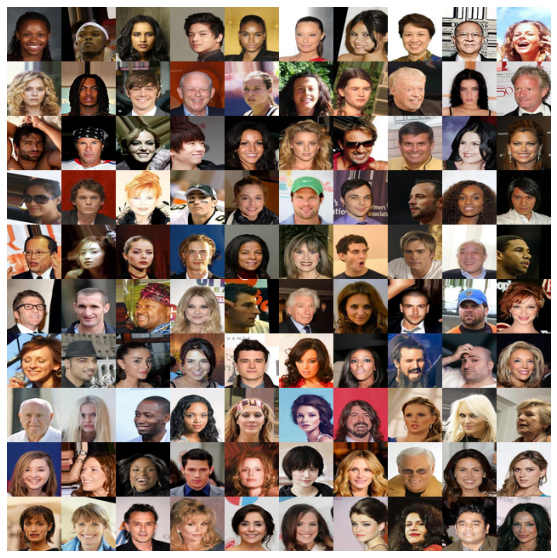

In [ ]:
def make_grid(imgs, nrow, padding=0):
    assert imgs.ndim == 4 and nrow > 0
    batch, height, width, ch = imgs.shape
    n = nrow * (batch // nrow + np.sign(batch % nrow))
    ncol = n // nrow
    pad = np.zeros((n-batch, height, width, ch), imgs.dtype)
    x = np.concatenate([imgs, pad], axis=0)
    if padding > 0:
        x = np.pad(x, ((0, 0), (0, padding), (0, padding), (0, 0)), 
                   'constant', constant_values=(0, 0))
        height += padding
        width += padding
    x = x.reshape(ncol, nrow, height, width, ch)
    x = x.transpose([0, 2, 1, 3, 4])
    x = x.reshape(height*ncol, width*nrow, ch)
    if padding > 0:
        x = x[:(height*ncol - padding), :(width*nrow - padding), :]
    return x

def plot_images(images, nrow=10, padding=0, img_name='sample_img.png', plotting=True):
    imgs = images.numpy()
    grid = make_grid(imgs, nrow, padding)
    grid = ((grid+1)*127.5).astype(np.uint8)
    plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(grid)
    plt.savefig(img_name, bbox_inches='tight', pad_inches=0.0)
    if plotting: plt.show()
    plt.close('all')

BATCH_SIZE = 1024
dataset = load_celeba(BATCH_SIZE)

temp1, temp2 = next(iter(dataset))
print(temp1.shape, temp2.shape)
plot_images(temp1[:100])

# モデルの作成

In [ ]:
BATCH_SIZE = 1024
Z_DIM = 128

k_init = tf.keras.initializers.HeNormal()

def create_G(dim=128):
    inputs = Input((1, 1, Z_DIM))
    x = Conv2DTranspose(8*dim, kernel_size=4, strides=1, padding='valid', 
                        kernel_initializer=k_init)(inputs)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2DTranspose(4*dim, kernel_size=5, strides=1, padding='valid', 
                        kernel_initializer=k_init)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2DTranspose(2*dim, kernel_size=5, strides=2, padding='same', 
                        kernel_initializer=k_init)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2DTranspose(dim, kernel_size=5, strides=2, padding='same', 
                        kernel_initializer=k_init)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2DTranspose(3, kernel_size=5, strides=2, padding='same', 
                        kernel_initializer=k_init)(x)
    outputs = Activation('tanh')(x)
    return Model(inputs, outputs)

def create_D(dim=128):
    inputs = Input((64, 64, 3))
    x = Conv2D(dim, kernel_size=5, strides=2, padding='same', 
               kernel_initializer=k_init)(inputs)
    x = LeakyReLU(0.2)(x)
    x = Conv2D(2*dim, kernel_size=5, strides=2, padding='same', 
               kernel_initializer=k_init)(x)
    x = LeakyReLU(0.2)(x)
    x = Conv2D(4*dim, kernel_size=5, strides=2, padding='same', 
               kernel_initializer=k_init)(x)
    x = LeakyReLU(0.2)(x)
    x = Conv2D(8*dim, kernel_size=5, strides=2, padding='same', 
               kernel_initializer=k_init)(x)
    x = LeakyReLU(0.2)(x)
    outputs = Conv2D(1, kernel_size=4, strides=1, padding='valid', 
                     kernel_initializer=k_init)(x)
    return Model(inputs, outputs)

In [ ]:
K.clear_session()

Z_DIM = 128
create_D().summary()
create_G().summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 32, 32, 128)       9728      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 256)       819456    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 256)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 512)         3277312   
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 512)         0     

In [ ]:
K.clear_session()

tf.keras.utils.plot_model(create_D(), 'netD_graph.png')
tf.keras.utils.plot_model(create_G(), 'netG_graph.png')
print()

# 訓練

Loading image_cache.pkl...
Completed.
Epoch: 000
	Step 0000000, d_loss: -34.067070, g_loss: 67.468796
		wd_D: 35.676254, gp_D: 1.609187
		wd_G: -60.263699, gp_G: 7.205100
	Step 0000099, d_loss: -43.988724, g_loss: 52.541649
		wd_D: 63.253429, gp_D: 19.264709
		wd_G: -34.604889, gp_G: 17.936760


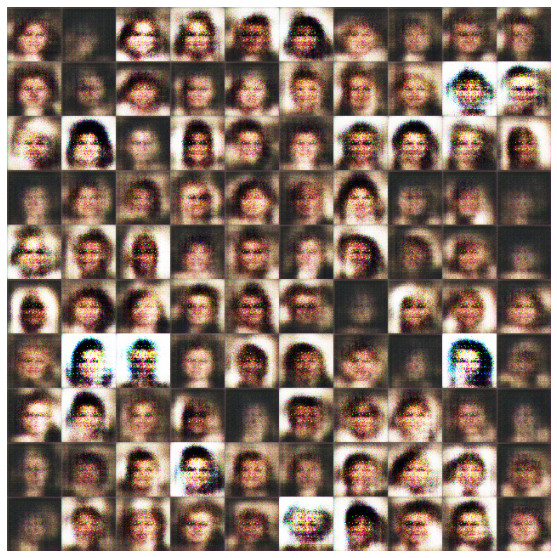

132.218196s is elapsed for epoch 000.
Epoch: 001
	Step 0000197, d_loss: -32.311756, g_loss: 28.673813
		wd_D: 42.605137, gp_D: 10.293383
		wd_G: -17.810230, gp_G: 10.863583
	Step 0000296, d_loss: -23.818485, g_loss: 18.234324
		wd_D: 30.438540, gp_D: 6.620055
		wd_G: -10.816706, gp_G: 7.417618
106.473078s is elapsed for epoch 001.
Epoch: 002
	Step 0000394, d_loss: -20.344894, g_loss: 1.151799
		wd_D: 24.672165, gp_D: 4.327273
		wd_G: 3.778123, gp_G: 4.929922
	Step 0000493, d_loss: -21.227077, g_loss: 23.041908
		wd_D: 27.211943, gp_D: 5.984864
		wd_G: -15.844655, gp_G: 7.197252


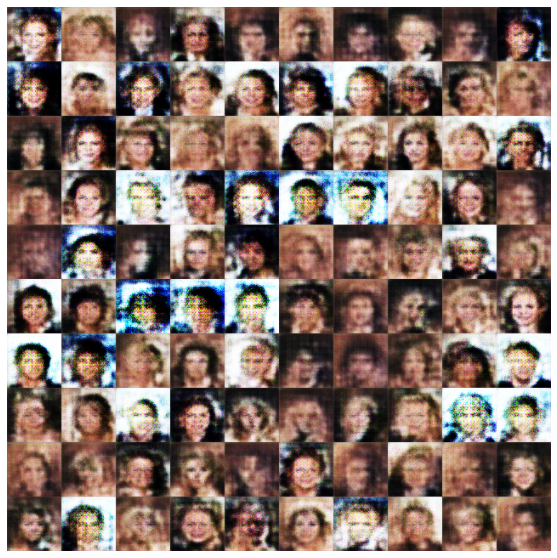

107.202967s is elapsed for epoch 002.
Epoch: 003
	Step 0000591, d_loss: -19.101219, g_loss: 24.430494
		wd_D: 24.142160, gp_D: 5.040943
		wd_G: -19.872534, gp_G: 4.557962
	Step 0000690, d_loss: -16.607906, g_loss: 23.148035
		wd_D: 23.068594, gp_D: 6.460686
		wd_G: -19.435162, gp_G: 3.712875
106.545499s is elapsed for epoch 003.
Epoch: 004
	Step 0000788, d_loss: -13.894014, g_loss: 10.234199
		wd_D: 17.720083, gp_D: 3.826070
		wd_G: -7.482761, gp_G: 2.751437
	Step 0000887, d_loss: -14.294024, g_loss: 10.489449
		wd_D: 17.894939, gp_D: 3.600916
		wd_G: -7.357032, gp_G: 3.132415


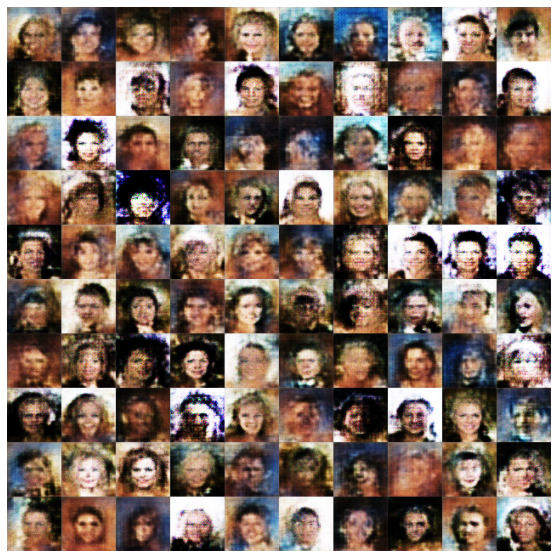

107.728089s is elapsed for epoch 004.
Epoch: 005
	Step 0000985, d_loss: -12.980338, g_loss: 6.488861
		wd_D: 16.948486, gp_D: 3.968146
		wd_G: -4.252072, gp_G: 2.236789
	Step 0001084, d_loss: -13.910267, g_loss: 8.255931
		wd_D: 16.969189, gp_D: 3.058920
		wd_G: -3.965219, gp_G: 4.290712
106.592343s is elapsed for epoch 005.
Epoch: 006
	Step 0001182, d_loss: -12.361755, g_loss: 8.595839
		wd_D: 14.950175, gp_D: 2.588419
		wd_G: -5.323511, gp_G: 3.272328
	Step 0001281, d_loss: -12.638737, g_loss: 5.787659
		wd_D: 14.660888, gp_D: 2.022151
		wd_G: -3.078713, gp_G: 2.708946


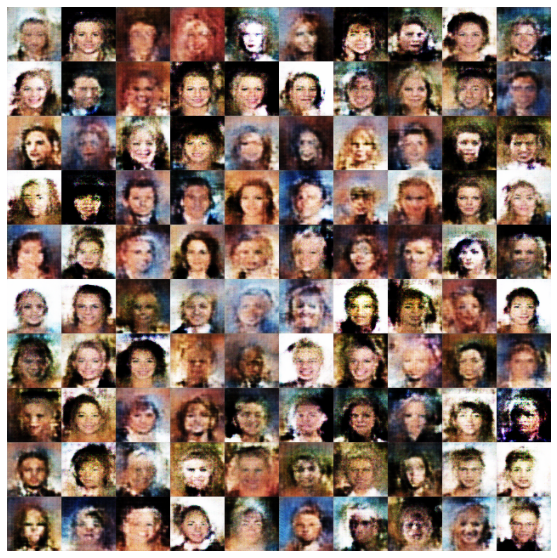

106.538640s is elapsed for epoch 006.
Epoch: 007
	Step 0001379, d_loss: -13.029264, g_loss: 5.875438
		wd_D: 14.834938, gp_D: 1.805674
		wd_G: -3.070401, gp_G: 2.805037
	Step 0001478, d_loss: -12.397532, g_loss: 6.542627
		wd_D: 15.189284, gp_D: 2.791753
		wd_G: -3.998240, gp_G: 2.544386
106.857942s is elapsed for epoch 007.
Epoch: 008
	Step 0001576, d_loss: -12.219209, g_loss: 14.703383
		wd_D: 15.227433, gp_D: 3.008224
		wd_G: -12.545173, gp_G: 2.158210
	Step 0001675, d_loss: -13.003642, g_loss: 7.237280
		wd_D: 15.264417, gp_D: 2.260774
		wd_G: -4.799894, gp_G: 2.437386


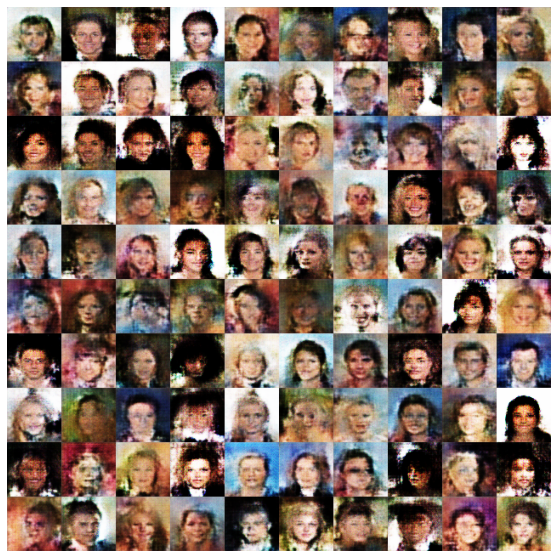

106.576863s is elapsed for epoch 008.
Epoch: 009
	Step 0001773, d_loss: -12.274347, g_loss: 5.673492
		wd_D: 14.004166, gp_D: 1.729818
		wd_G: -3.276571, gp_G: 2.396921
	Step 0001872, d_loss: -12.442201, g_loss: 9.671107
		wd_D: 14.814371, gp_D: 2.372169
		wd_G: -7.296120, gp_G: 2.374987
107.449387s is elapsed for epoch 009.
Epoch: 010
	Step 0001970, d_loss: -12.479099, g_loss: 9.854394
		wd_D: 14.670889, gp_D: 2.191789
		wd_G: -7.393305, gp_G: 2.461089
	Step 0002069, d_loss: -12.410987, g_loss: 7.604863
		wd_D: 14.905994, gp_D: 2.495009
		wd_G: -5.492303, gp_G: 2.112561


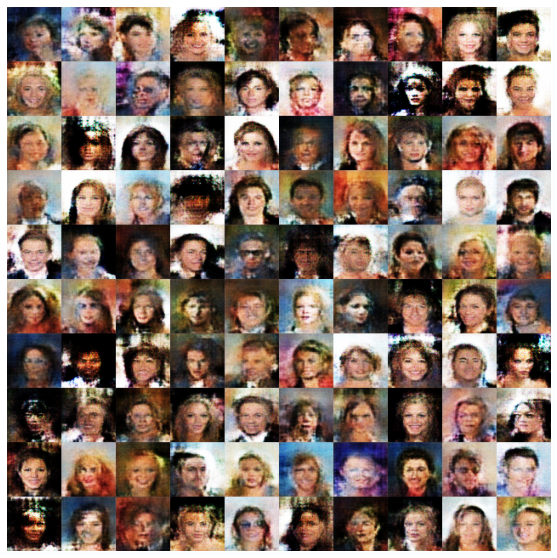

106.996965s is elapsed for epoch 010.
Epoch: 011
	Step 0002167, d_loss: -12.081581, g_loss: 3.966979
		wd_D: 13.762374, gp_D: 1.680793
		wd_G: -1.883187, gp_G: 2.083792
	Step 0002266, d_loss: -11.699736, g_loss: 5.215590
		wd_D: 14.765103, gp_D: 3.065367
		wd_G: -3.287852, gp_G: 1.927739
106.381796s is elapsed for epoch 011.
Epoch: 012
	Step 0002364, d_loss: -12.170627, g_loss: 11.316648
		wd_D: 15.865386, gp_D: 3.694761
		wd_G: -9.927007, gp_G: 1.389641
	Step 0002463, d_loss: -12.044004, g_loss: 11.619387
		wd_D: 13.990101, gp_D: 1.946096
		wd_G: -9.213533, gp_G: 2.405853


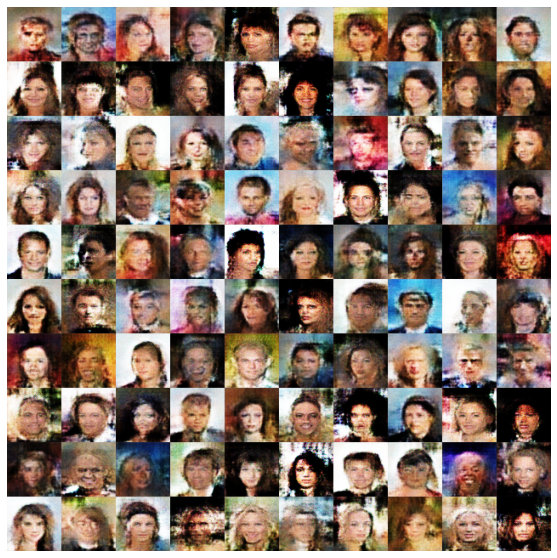

106.741616s is elapsed for epoch 012.
Epoch: 013
	Step 0002561, d_loss: -11.639071, g_loss: 12.998029
		wd_D: 14.701735, gp_D: 3.062665
		wd_G: -10.918346, gp_G: 2.079683
	Step 0002660, d_loss: -11.216899, g_loss: 9.665499
		wd_D: 12.999132, gp_D: 1.782234
		wd_G: -7.901558, gp_G: 1.763941
106.587162s is elapsed for epoch 013.
Epoch: 014
	Step 0002758, d_loss: -11.450120, g_loss: 7.102950
		wd_D: 12.984507, gp_D: 1.534386
		wd_G: -5.015973, gp_G: 2.086977
	Step 0002857, d_loss: -11.888468, g_loss: 1.722553
		wd_D: 14.455984, gp_D: 2.567518
		wd_G: 0.660310, gp_G: 2.382862


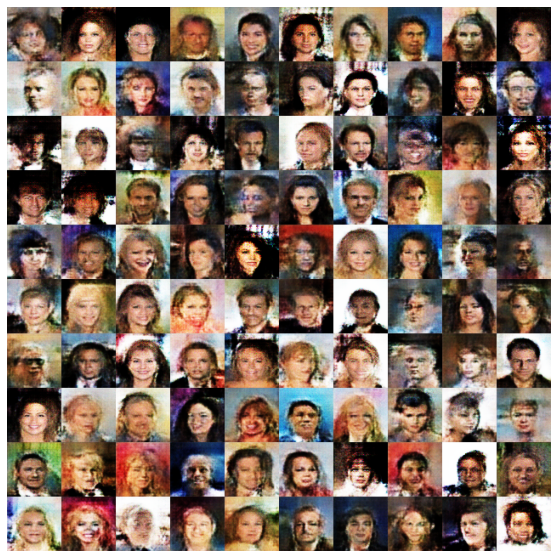

107.045327s is elapsed for epoch 014.
Epoch: 015
	Step 0002955, d_loss: -11.631582, g_loss: 12.559877
		wd_D: 13.613359, gp_D: 1.981777
		wd_G: -10.237741, gp_G: 2.322135
	Step 0003054, d_loss: -11.178171, g_loss: 6.484052
		wd_D: 13.204636, gp_D: 2.026464
		wd_G: -4.419837, gp_G: 2.064215
107.176640s is elapsed for epoch 015.
Epoch: 016
	Step 0003152, d_loss: -11.409739, g_loss: 6.878029
		wd_D: 13.742947, gp_D: 2.333208
		wd_G: -4.777156, gp_G: 2.100873
	Step 0003251, d_loss: -11.168751, g_loss: 9.322052
		wd_D: 13.248151, gp_D: 2.079400
		wd_G: -7.834707, gp_G: 1.487344


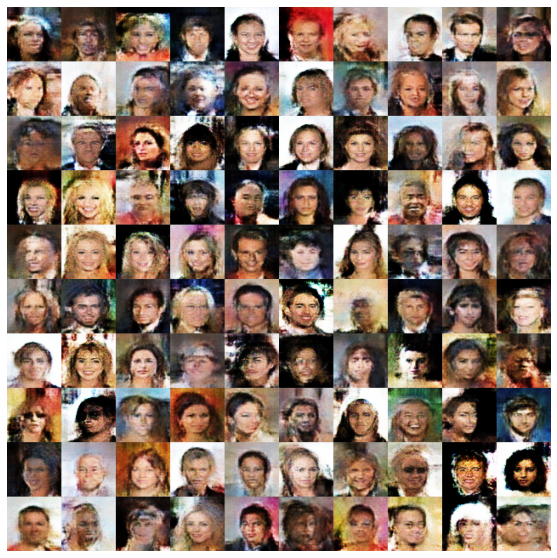

107.170987s is elapsed for epoch 016.
Epoch: 017
	Step 0003349, d_loss: -10.826817, g_loss: 7.682759
		wd_D: 13.712001, gp_D: 2.885184
		wd_G: -6.105656, gp_G: 1.577103
	Step 0003448, d_loss: -11.254025, g_loss: 4.157360
		wd_D: 13.594529, gp_D: 2.340506
		wd_G: -1.838552, gp_G: 2.318808
106.510817s is elapsed for epoch 017.
Epoch: 018
	Step 0003546, d_loss: -10.930361, g_loss: 5.876027
		wd_D: 12.704402, gp_D: 1.774041
		wd_G: -4.056215, gp_G: 1.819812
	Step 0003645, d_loss: -10.537535, g_loss: 4.293885
		wd_D: 12.403576, gp_D: 1.866042
		wd_G: -2.332827, gp_G: 1.961058


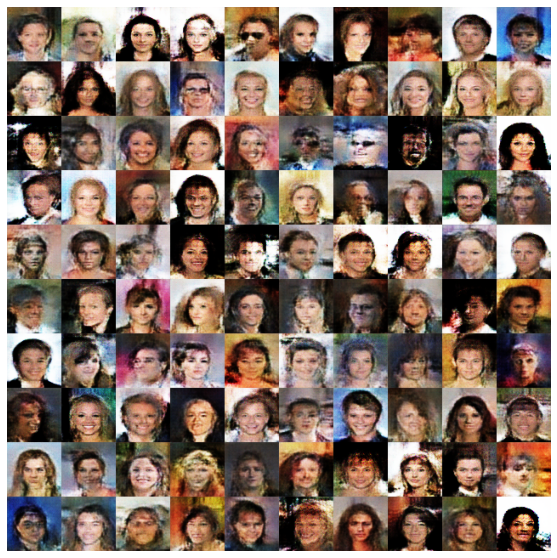

107.117284s is elapsed for epoch 018.
Epoch: 019
	Step 0003743, d_loss: -10.592287, g_loss: 9.359461
		wd_D: 12.752132, gp_D: 2.159845
		wd_G: -7.806912, gp_G: 1.552548
	Step 0003842, d_loss: -10.255883, g_loss: 9.894958
		wd_D: 12.042923, gp_D: 1.787039
		wd_G: -8.217745, gp_G: 1.677214
106.764583s is elapsed for epoch 019.
Epoch: 020
	Step 0003940, d_loss: -10.542053, g_loss: 12.896292
		wd_D: 12.336269, gp_D: 1.794215
		wd_G: -11.300432, gp_G: 1.595859
	Step 0004039, d_loss: -10.057231, g_loss: 11.018204
		wd_D: 12.086653, gp_D: 2.029422
		wd_G: -9.741074, gp_G: 1.277131


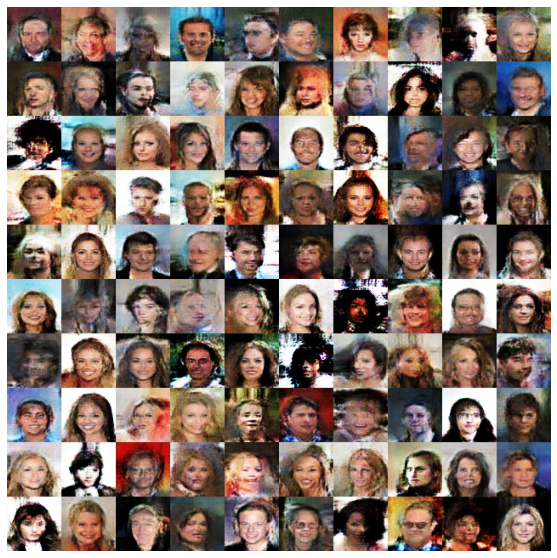

106.853300s is elapsed for epoch 020.
Epoch: 021
	Step 0004137, d_loss: -10.019688, g_loss: 12.111601
		wd_D: 12.161007, gp_D: 2.141319
		wd_G: -10.887607, gp_G: 1.223995
	Step 0004236, d_loss: -9.935658, g_loss: 6.692296
		wd_D: 12.284969, gp_D: 2.349311
		wd_G: -5.663401, gp_G: 1.028895
106.905884s is elapsed for epoch 021.
Epoch: 022
	Step 0004334, d_loss: -10.202971, g_loss: 9.471038
		wd_D: 12.077989, gp_D: 1.875019
		wd_G: -7.865721, gp_G: 1.605317
	Step 0004433, d_loss: -9.860069, g_loss: 1.388199
		wd_D: 12.217791, gp_D: 2.357722
		wd_G: 0.135529, gp_G: 1.523728


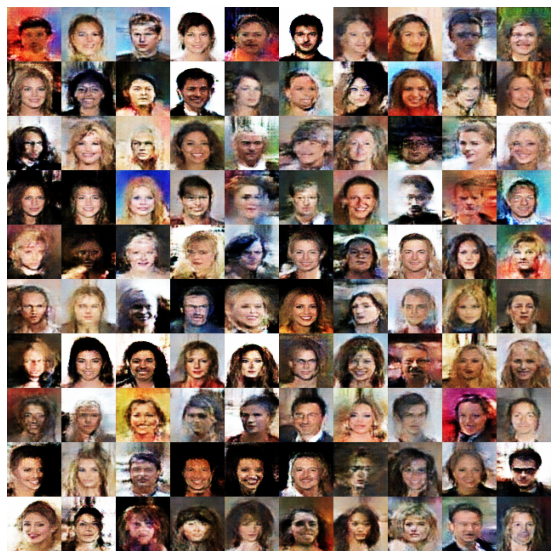

107.045381s is elapsed for epoch 022.
Epoch: 023
	Step 0004531, d_loss: -10.174783, g_loss: 5.271279
		wd_D: 12.045461, gp_D: 1.870678
		wd_G: -3.729623, gp_G: 1.541657
	Step 0004630, d_loss: -9.924247, g_loss: 3.352650
		wd_D: 11.824253, gp_D: 1.900006
		wd_G: -1.634620, gp_G: 1.718030
106.825316s is elapsed for epoch 023.
Epoch: 024
	Step 0004728, d_loss: -10.300117, g_loss: 5.239787
		wd_D: 12.331703, gp_D: 2.031587
		wd_G: -3.391703, gp_G: 1.848084
	Step 0004827, d_loss: -9.912500, g_loss: 11.886319
		wd_D: 11.979397, gp_D: 2.066897
		wd_G: -10.395166, gp_G: 1.491153


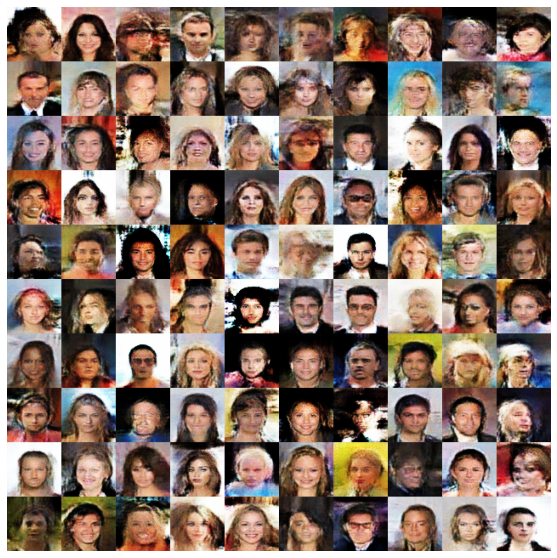

106.895144s is elapsed for epoch 024.
Epoch: 025
	Step 0004925, d_loss: -9.609320, g_loss: 12.223931
		wd_D: 11.068246, gp_D: 1.458927
		wd_G: -10.684417, gp_G: 1.539515
	Step 0005024, d_loss: -9.787912, g_loss: 3.574404
		wd_D: 11.703540, gp_D: 1.915627
		wd_G: -1.952717, gp_G: 1.621687
106.738973s is elapsed for epoch 025.
Epoch: 026
	Step 0005122, d_loss: -9.654457, g_loss: 3.167785
		wd_D: 11.239870, gp_D: 1.585412
		wd_G: -1.618282, gp_G: 1.549504
	Step 0005221, d_loss: -9.684558, g_loss: 7.105545
		wd_D: 11.633835, gp_D: 1.949276
		wd_G: -5.753779, gp_G: 1.351766


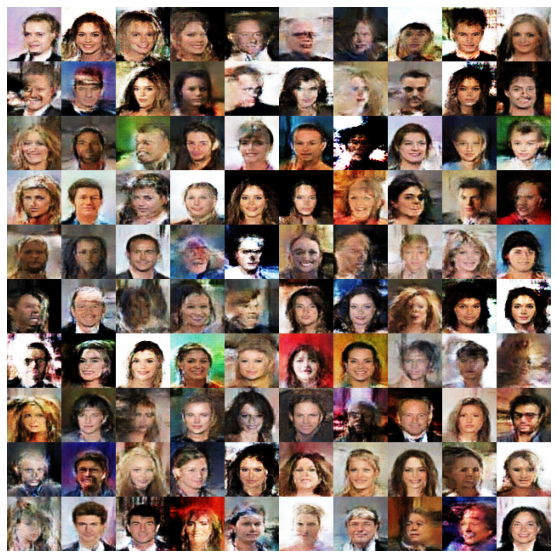

106.877823s is elapsed for epoch 026.
Epoch: 027
	Step 0005319, d_loss: -9.496924, g_loss: 9.176776
		wd_D: 10.994197, gp_D: 1.497272
		wd_G: -7.767274, gp_G: 1.409502
	Step 0005418, d_loss: -9.751169, g_loss: -1.176537
		wd_D: 11.719915, gp_D: 1.968746
		wd_G: 2.958212, gp_G: 1.781676
106.564418s is elapsed for epoch 027.
Epoch: 028
	Step 0005516, d_loss: -9.442228, g_loss: 12.036400
		wd_D: 10.775742, gp_D: 1.333511
		wd_G: -10.686605, gp_G: 1.349794
	Step 0005615, d_loss: -9.593736, g_loss: 5.381060
		wd_D: 11.488286, gp_D: 1.894551
		wd_G: -3.971669, gp_G: 1.409392


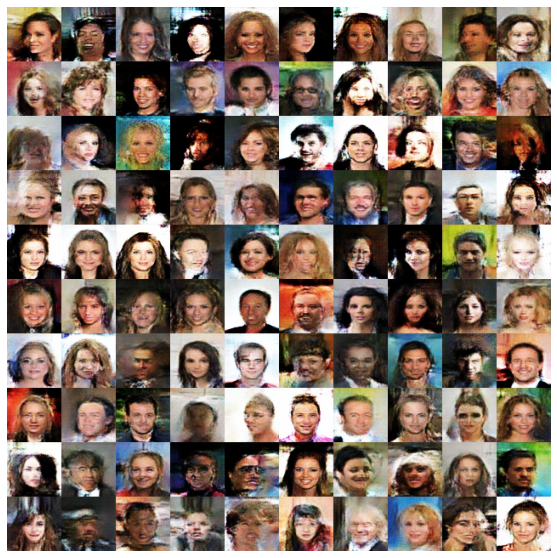

107.030237s is elapsed for epoch 028.
Epoch: 029
	Step 0005713, d_loss: -9.671533, g_loss: 3.010247
		wd_D: 11.500833, gp_D: 1.829299
		wd_G: -1.388525, gp_G: 1.621722
	Step 0005812, d_loss: -9.285281, g_loss: 6.074615
		wd_D: 10.909580, gp_D: 1.624299
		wd_G: -4.646646, gp_G: 1.427970
106.579298s is elapsed for epoch 029.
Epoch: 030
	Step 0005910, d_loss: -9.361211, g_loss: 9.033869
		wd_D: 10.704508, gp_D: 1.343299
		wd_G: -7.514406, gp_G: 1.519463
	Step 0006009, d_loss: -9.356834, g_loss: 12.960783
		wd_D: 10.749031, gp_D: 1.392196
		wd_G: -11.510262, gp_G: 1.450520


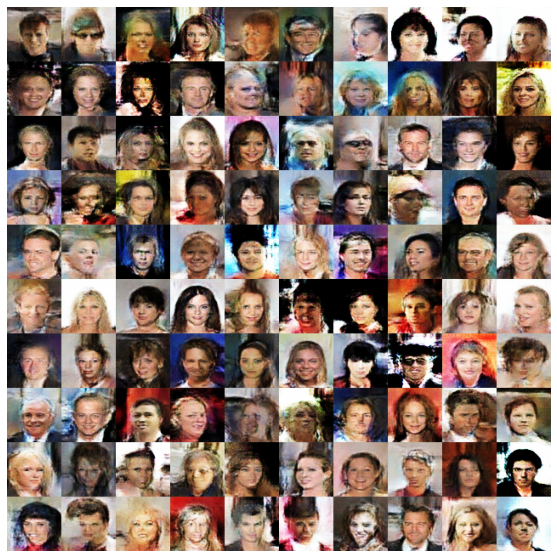

106.920413s is elapsed for epoch 030.
Epoch: 031
	Step 0006107, d_loss: -9.501761, g_loss: 8.458952
		wd_D: 11.633898, gp_D: 2.132135
		wd_G: -6.986020, gp_G: 1.472932
	Step 0006206, d_loss: -9.269494, g_loss: 1.446782
		wd_D: 10.893871, gp_D: 1.624377
		wd_G: 0.357829, gp_G: 1.804611
106.609159s is elapsed for epoch 031.
Epoch: 032
	Step 0006304, d_loss: -9.308470, g_loss: 2.175282
		wd_D: 10.732812, gp_D: 1.424342
		wd_G: -0.711834, gp_G: 1.463447
	Step 0006403, d_loss: -9.433457, g_loss: -0.387748
		wd_D: 11.108128, gp_D: 1.674671
		wd_G: 1.820306, gp_G: 1.432558


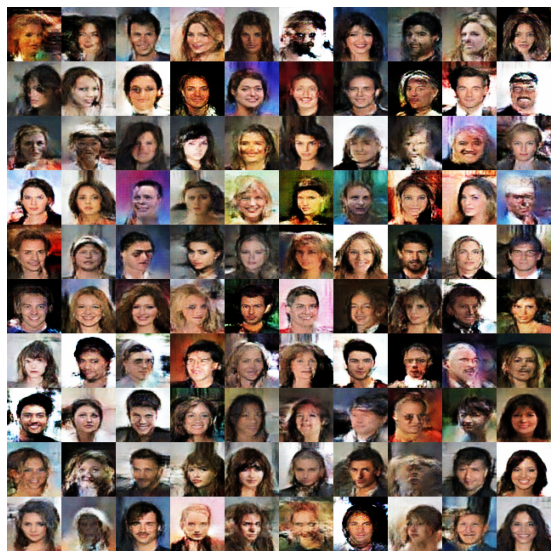

106.505591s is elapsed for epoch 032.
Epoch: 033
	Step 0006501, d_loss: -8.997635, g_loss: 6.212906
		wd_D: 10.534206, gp_D: 1.536572
		wd_G: -4.782498, gp_G: 1.430408
	Step 0006600, d_loss: -9.282728, g_loss: 5.839370
		wd_D: 10.775338, gp_D: 1.492610
		wd_G: -4.394144, gp_G: 1.445225
106.494404s is elapsed for epoch 033.
Epoch: 034
	Step 0006698, d_loss: -9.030008, g_loss: 8.017420
		wd_D: 10.198908, gp_D: 1.168900
		wd_G: -6.398362, gp_G: 1.619057
	Step 0006797, d_loss: -9.233301, g_loss: 5.932138
		wd_D: 10.481285, gp_D: 1.247984
		wd_G: -4.396196, gp_G: 1.535943


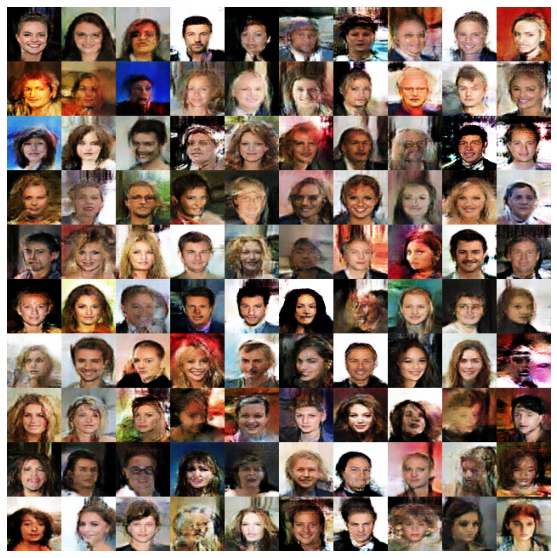

107.039254s is elapsed for epoch 034.
Epoch: 035
	Step 0006895, d_loss: -8.948780, g_loss: 6.708456
		wd_D: 10.427041, gp_D: 1.478261
		wd_G: -5.559082, gp_G: 1.149373
	Step 0006994, d_loss: -8.710636, g_loss: 11.264315
		wd_D: 9.993952, gp_D: 1.283317
		wd_G: -10.153602, gp_G: 1.110712
106.518378s is elapsed for epoch 035.
Epoch: 036
	Step 0007092, d_loss: -9.566931, g_loss: 3.190847
		wd_D: 11.324041, gp_D: 1.757110
		wd_G: -1.440847, gp_G: 1.750000
	Step 0007191, d_loss: -8.856639, g_loss: 3.511461
		wd_D: 10.455996, gp_D: 1.599356
		wd_G: -2.214453, gp_G: 1.297008


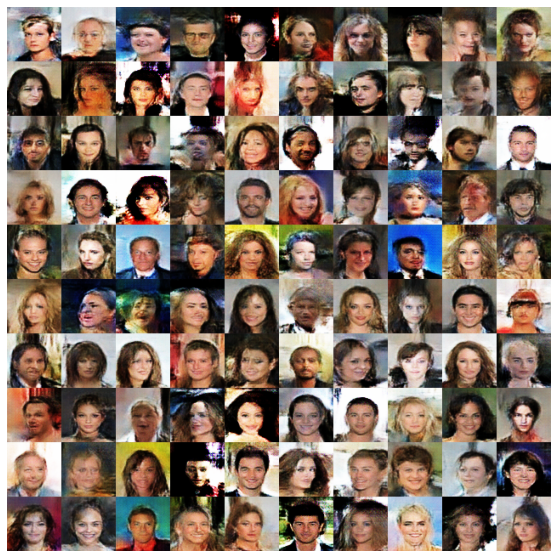

106.842483s is elapsed for epoch 036.
Epoch: 037
	Step 0007289, d_loss: -8.820388, g_loss: 6.743042
		wd_D: 10.405763, gp_D: 1.585374
		wd_G: -5.613691, gp_G: 1.129351
	Step 0007388, d_loss: -8.976266, g_loss: 3.232162
		wd_D: 10.367088, gp_D: 1.390823
		wd_G: -1.814584, gp_G: 1.417578
106.583991s is elapsed for epoch 037.
Epoch: 038
	Step 0007486, d_loss: -8.671314, g_loss: 5.482561
		wd_D: 10.071533, gp_D: 1.400219
		wd_G: -4.205590, gp_G: 1.276971
	Step 0007585, d_loss: -8.843769, g_loss: 6.546396
		wd_D: 10.121826, gp_D: 1.278057
		wd_G: -5.097645, gp_G: 1.448751


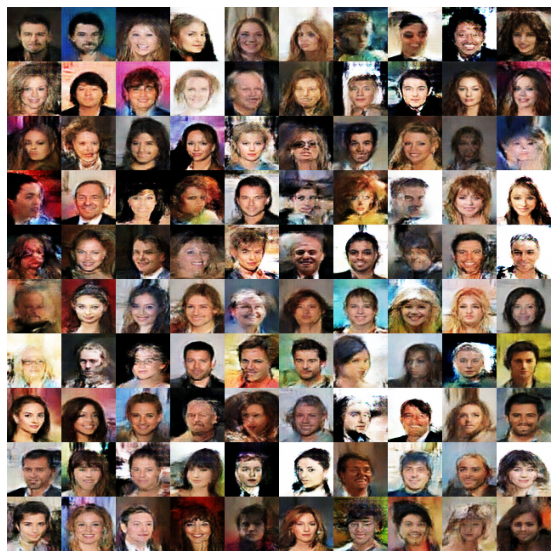

106.892582s is elapsed for epoch 038.
Epoch: 039
	Step 0007683, d_loss: -8.613267, g_loss: 4.887447
		wd_D: 10.080937, gp_D: 1.467671
		wd_G: -3.442343, gp_G: 1.445104
	Step 0007782, d_loss: -8.690747, g_loss: 4.794160
		wd_D: 10.074110, gp_D: 1.383364
		wd_G: -3.388839, gp_G: 1.405321
106.359537s is elapsed for epoch 039.
Epoch: 040
	Step 0007880, d_loss: -8.599239, g_loss: 5.097076
		wd_D: 9.764690, gp_D: 1.165451
		wd_G: -3.844945, gp_G: 1.252130
	Step 0007979, d_loss: -8.904024, g_loss: -0.015818
		wd_D: 10.523408, gp_D: 1.619382
		wd_G: 1.632180, gp_G: 1.616362


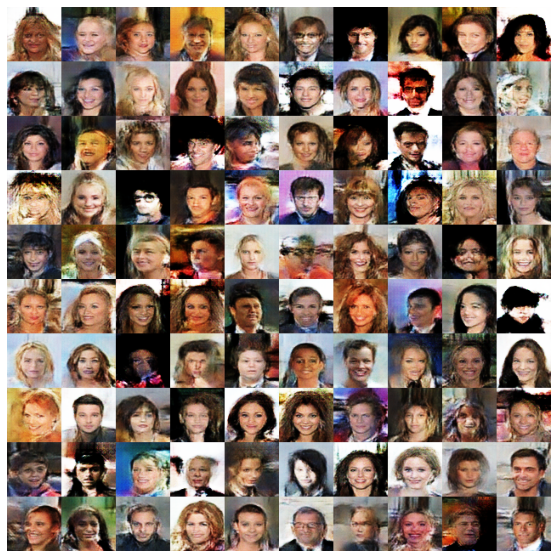

107.304939s is elapsed for epoch 040.
Epoch: 041
	Step 0008077, d_loss: -8.688125, g_loss: 6.774421
		wd_D: 10.071861, gp_D: 1.383736
		wd_G: -5.389345, gp_G: 1.385076
	Step 0008176, d_loss: -8.650076, g_loss: 9.494473
		wd_D: 10.076548, gp_D: 1.426472
		wd_G: -8.183115, gp_G: 1.311356
106.565984s is elapsed for epoch 041.
Epoch: 042
	Step 0008274, d_loss: -8.899656, g_loss: 2.029765
		wd_D: 10.221251, gp_D: 1.321594
		wd_G: -0.380068, gp_G: 1.649697
	Step 0008373, d_loss: -8.508047, g_loss: 1.247940
		wd_D: 9.968525, gp_D: 1.460477
		wd_G: 0.248221, gp_G: 1.496161


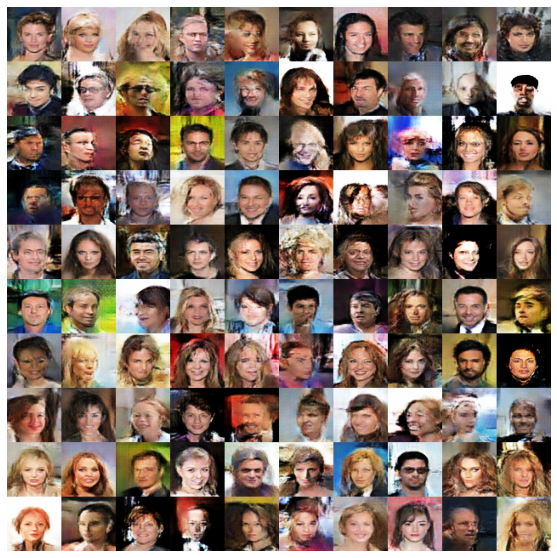

106.806014s is elapsed for epoch 042.
Epoch: 043
	Step 0008471, d_loss: -8.376089, g_loss: 0.688858
		wd_D: 9.640705, gp_D: 1.264616
		wd_G: 0.630979, gp_G: 1.319837
	Step 0008570, d_loss: -8.449129, g_loss: 8.084042
		wd_D: 9.747864, gp_D: 1.298734
		wd_G: -6.807009, gp_G: 1.277033
106.344638s is elapsed for epoch 043.
Epoch: 044
	Step 0008668, d_loss: -8.340257, g_loss: 0.548557
		wd_D: 9.807640, gp_D: 1.467383
		wd_G: 0.775355, gp_G: 1.323912
	Step 0008767, d_loss: -8.425213, g_loss: 13.994040
		wd_D: 9.670648, gp_D: 1.245435
		wd_G: -12.951689, gp_G: 1.042351


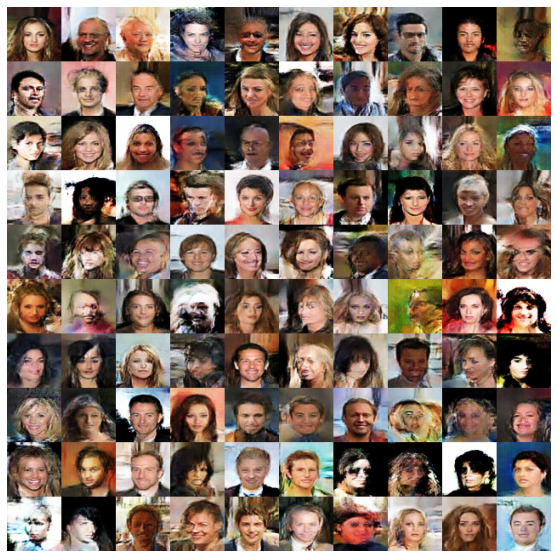

106.714601s is elapsed for epoch 044.
Epoch: 045
	Step 0008865, d_loss: -8.268049, g_loss: 0.153184
		wd_D: 9.499225, gp_D: 1.231177
		wd_G: 1.128407, gp_G: 1.281591
	Step 0008964, d_loss: -8.445731, g_loss: 10.390466
		wd_D: 9.576324, gp_D: 1.130594
		wd_G: -9.194273, gp_G: 1.196192
107.109295s is elapsed for epoch 045.
Epoch: 046
	Step 0009062, d_loss: -8.290937, g_loss: 3.932132
		wd_D: 9.553548, gp_D: 1.262610
		wd_G: -2.526734, gp_G: 1.405398
	Step 0009161, d_loss: -8.252182, g_loss: 8.213284
		wd_D: 9.521413, gp_D: 1.269231
		wd_G: -6.996474, gp_G: 1.216811


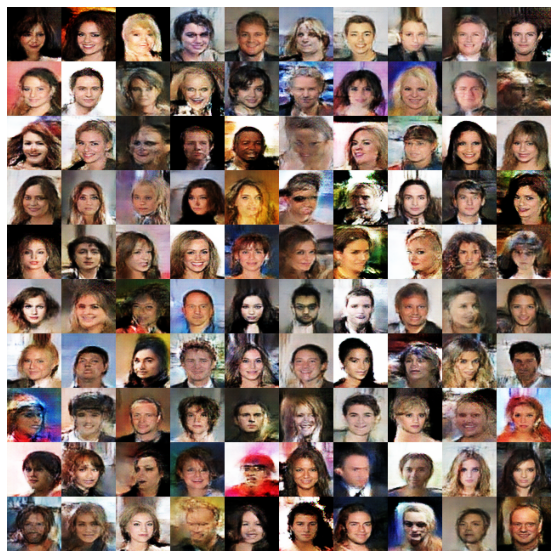

106.923514s is elapsed for epoch 046.
Epoch: 047
	Step 0009259, d_loss: -8.183435, g_loss: 2.477032
		wd_D: 9.729658, gp_D: 1.546224
		wd_G: -1.321972, gp_G: 1.155060
	Step 0009358, d_loss: -8.258770, g_loss: 6.605356
		wd_D: 9.318520, gp_D: 1.059750
		wd_G: -5.260195, gp_G: 1.345162
106.737127s is elapsed for epoch 047.
Epoch: 048
	Step 0009456, d_loss: -8.617938, g_loss: -1.944338
		wd_D: 10.069137, gp_D: 1.451198
		wd_G: 3.527371, gp_G: 1.583034
	Step 0009555, d_loss: -8.304691, g_loss: 5.981402
		wd_D: 9.532679, gp_D: 1.227987
		wd_G: -4.465729, gp_G: 1.515673


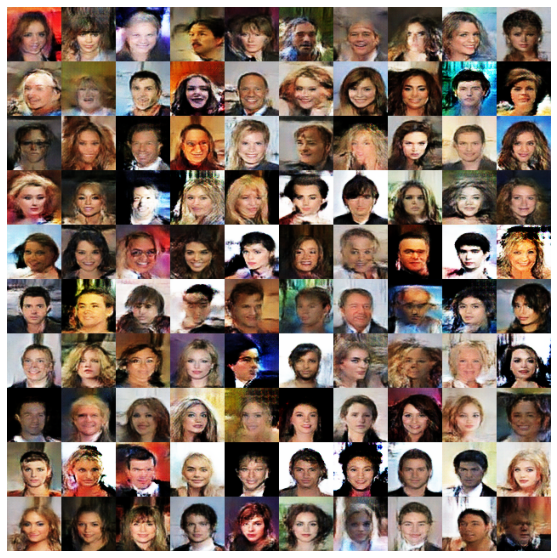

106.955948s is elapsed for epoch 048.
Epoch: 049
	Step 0009653, d_loss: -7.805697, g_loss: 3.908350
		wd_D: 9.175271, gp_D: 1.369573
		wd_G: -3.071375, gp_G: 0.836975
	Step 0009752, d_loss: -7.792539, g_loss: 5.857913
		wd_D: 8.903326, gp_D: 1.110787
		wd_G: -4.637329, gp_G: 1.220585
106.541249s is elapsed for epoch 049.
Train time: 89.433393min.


In [ ]:
K.clear_session()

BATCH_SIZE = 1024
Z_DIM = 128
STEPS_PER_EPOCH = 202599 // BATCH_SIZE + 1

out_dir = 'out'
os.makedirs(out_dir, exist_ok=True)

with strategy.scope():
    netD = create_D()
    netG = create_G()
    optD = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.999)
    optG = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.999)
    dataset = load_celeba(BATCH_SIZE)
    dataset = strategy.experimental_distribute_dataset(dataset)

    class Losses:
        @staticmethod
        def crossentropy_loss(logits, loss_type):
            assert loss_type in ['gen', 'dis_real', 'dis_fake']
            p = tf.sigmoid(logits)
            epsilon = 1e-16
            if loss_type == 'gen':
                return -tf.reduce_mean(tf.math.log(p+epsilon), axis=(1,2,3))
            elif loss_type == 'dis_real':
                return -tf.reduce_mean(tf.math.log(p+epsilon), axis=(1,2,3))
            else:
                return -tf.reduce_mean(tf.math.log(1-p+epsilon), axis=(1,2,3))
        @staticmethod
        def hinge_loss(logits, loss_type):
            assert loss_type in ['gen', 'dis_real', 'dis_fake']
            if loss_type == 'gen':
                return tf.reduce_mean(logits, axis=(1,2,3))
            elif loss_type == 'dis_real':
                minval = tf.minimum(logits-1, tf.zeros(logits.shape, dtype=logits.dtype))
                return -tf.reduce_mean(minval, axis=(1,2,3))
            else:
                minval = tf.minimum(-logits-1, tf.zeros(logits.shape, dtype=logits.dtype))
                return -tf.reduce_mean(minval, axis=(1,2,3))
        @staticmethod
        def wasserstein_loss(logits, loss_type):
            assert loss_type in ['gen', 'dis_real', 'dis_fake']
            if loss_type == 'gen':
                return -tf.reduce_mean(logits, axis=(1,2,3))
            elif loss_type == 'dis_real':
                return -tf.reduce_mean(logits, axis=(1,2,3))
            else:
                return tf.reduce_mean(logits, axis=(1,2,3))
        @staticmethod
        def generator_loss(img_fake):
            return Losses.wasserstein_loss(img_fake, 'gen')
        @staticmethod
        def discriminator_loss(logits_real, logits_fake):
            return Losses.wasserstein_loss(logits_real, 'dis_real') + Losses.wasserstein_loss(logits_fake, 'dis_fake')
    
    def calc_gp(real, fake, lam=10):
        b_size = real.shape[0]
        alpha = tf.random.uniform((b_size, 1, 1, 1), 0.0, 1.0)
        inter = alpha * fake + (1-alpha) * real
        with tf.GradientTape() as tape_gp:
            tape_gp.watch(inter)
            pred = netD(inter)
        grad = tape_gp.gradient(pred, inter)
        slopes = tf.sqrt(tf.reduce_sum(tf.square(grad), axis=(1, 2, 3)))
        gp = lam * tf.reduce_sum((slopes - 1.0)**2)
        return gp
    
    @distributed(Reduction.SUM, Reduction.SUM, Reduction.CONCAT, Reduction.SUM, Reduction.SUM, Reduction.SUM, Reduction.SUM)
    def train_on_batch(real1, real2):
        real = tf.concat([real1, real2], axis=0)
        b_size = real.shape[0]
        z = tf.random.normal((b_size, 1, 1, Z_DIM))
        with tf.GradientTape() as tape_D, tf.GradientTape() as tape_G:
            fake = netG(z, training=True)

        d_loss = 0.0
        for c in range(3):
            with tape_D:
                real_out = netD(real, training=True)
                fake_out = netD(fake, training=True)
                wd_loss_D = tf.reduce_sum(Losses.discriminator_loss(real_out, fake_out)) / BATCH_SIZE
                gp_D = calc_gp(real, fake) / BATCH_SIZE
                d_loss = wd_loss_D + gp_D
            grad_D = tape_D.gradient(d_loss, netD.trainable_weights)
            optD.apply_gradients(zip(grad_D, netD.trainable_weights))
        
        with tape_G:
            fake_out = netD(fake, training=False)
            wd_loss_G = tf.reduce_sum(Losses.generator_loss(fake_out)) / BATCH_SIZE
            gp_G = calc_gp(real, fake) / BATCH_SIZE
            g_loss = wd_loss_G + gp_G
        grad_G = tape_G.gradient(g_loss, netG.trainable_weights)
        optG.apply_gradients(zip(grad_G, netG.trainable_weights))

        return d_loss, g_loss, fake, wd_loss_D, gp_D, wd_loss_G, gp_G

    data = []
    total_step = 0
    t0 = time.time()
    EPOCH = 50
    for epoch in range(EPOCH):
        t1 = time.time()
        print(f'Epoch: {str(epoch).zfill(3)}')
        for step, (real1, real2) in enumerate(dataset):
            # 最後のstepでNonetypeをTensorに変換しようとしやがるのでcontinueさせる。
            if step==(STEPS_PER_EPOCH-1): continue
            d_loss, g_loss, fake, wd_loss_D, gp_D, wd_loss_G, gp_G = train_on_batch(real1, real2)
            if step%(STEPS_PER_EPOCH//2)==0:
                print(f'\tStep {str(total_step).zfill(7)}, d_loss: {d_loss.numpy():f}, g_loss: {g_loss.numpy():f}')
                print(f'\t\twd_D: {-wd_loss_D.numpy():f}, gp_D: {gp_D.numpy():f}')
                print(f'\t\twd_G: {-wd_loss_G.numpy():f}, gp_G: {gp_G.numpy():f}')
            data.append([d_loss.numpy(), g_loss.numpy(), -wd_loss_D.numpy(), gp_D.numpy(), -wd_loss_G.numpy(), gp_G.numpy()])
            total_step += 1
        plot_images(fake[:100], img_name=f'./{out_dir}/epoch_{str(epoch).zfill(3)}.png', plotting=(epoch%2==0))
        print(f'{time.time()-t1:f}s is elapsed for epoch {str(epoch).zfill(3)}.')
    with open(f'data.pkl', 'wb') as fp: pickle.dump(data, fp)
    print(f'Train time: {(time.time()-t0)/60:f}min.')

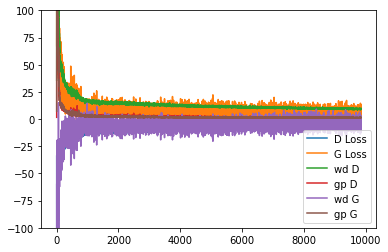

<Figure size 432x288 with 0 Axes>

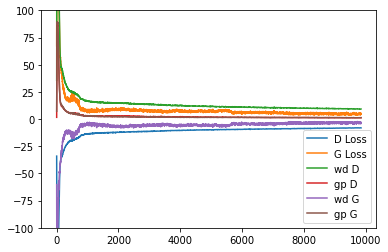

<Figure size 432x288 with 0 Axes>

In [ ]:
data = np.array((data))
step_num = np.arange(data.shape[0])
d_loss = data[:, 0]
g_loss = data[:, 1]
wd_D = data[:, 2]
gp_D = data[:, 3]
wd_G = data[:, 4]
gp_G = data[:, 5]

def smoothing(x, alpha=0.9):
    y = np.zeros_like(x)
    y[0] = x[0]
    for i in range(1, len(x)):
        y[i] = alpha*y[i-1] + (1-alpha)*x[i]
    return y

plt.figure()
plt.plot(step_num, d_loss, label='D Loss')
plt.plot(step_num, g_loss, label='G Loss')
plt.plot(step_num, wd_D, label='wd D')
plt.plot(step_num, gp_D, label='gp D')
plt.plot(step_num, wd_G, label='wd G')
plt.plot(step_num, gp_G, label='gp G')
plt.ylim(-100, 100)
plt.legend()
plt.savefig('losses.png')
plt.show()
plt.clf()

plt.figure()
plt.plot(step_num, smoothing(d_loss), label='D Loss')
plt.plot(step_num, smoothing(g_loss), label='G Loss')
plt.plot(step_num, smoothing(wd_D), label='wd D')
plt.plot(step_num, smoothing(gp_D), label='gp D')
plt.plot(step_num, smoothing(wd_G), label='wd G')
plt.plot(step_num, smoothing(gp_G), label='gp G')
plt.ylim(-100, 100)
plt.legend()
plt.savefig('losses_smoothed.png')
plt.show()
plt.clf()

In [ ]:
!zip out.zip ./out/*.png > /dev/null